En este notebook se va a realizar el ejercicio de "Style transfer" represantado en el libro de Deep Learning with Python de François Chollet pp 312

# <font color="#9E1B32">Intro

##  <font color="#9E1B32">¿Qúe es style transfer?
Style transfer es una técnica de Computer Vision que consiste en mezclar dos imágenes. Una de ellas es la __imagen contenido/original__, la otra es la imagen __estilo/referencia__. La idea es conseguir introducir las features de la imagen estilo, habitualmente cuadros como el grito o la noche estrellada, en la imagen contenido para darle forma. El resultado es la __imagen generada__.
    
La imagen estilo básicamente significa texturas, colores y patrones de la imagen. La imagen contenido es la estructura de la imagen. La imagen generada es la mezcla de ambas.

Ejemplos muy chulos: https://deepart.io/
<img src="../Images/style_transfer_example.jpg">

Estos efectos se consiguen mediante deep learning. Como siempre el objetivo es minimizar una función de pérdida que debemos construir. Está funcion se define de manera que conservemos el contenido de la imagen original adoptando el estilo de la imagen de referencia. Si pudiesemos definir la función estilo y contenido la función loss sería:

**loss = distancia(estilo(imagen_referencia) - estilo(imagen_generada)) + distancia(contenido(imagen_original) - contenido(imagen_generada))**

Donde la distancia es la norma L2, "contenido" mide la representación de contenido de una imagen y "estilo" mide la representación de estilo de una imagen. Minimazando esta función coseguimos que el estilo de la imagen generada sea cercano a la imagen de referencia y el contenido sea cercano a la imagen original.

Las activaciones de las primeras capas de una red neuronal contienen información local sobre una imagen y las activaciones de capas profundas contienen información global y abstracta de la imagen. El contenido de una imagen es siempre muy abstracto y global. Entonces para definir la función contenido haremos la normal L2 entre las activaciones de la última capa convolucional de una red entrenada para la imagen original menos estas misma activaciones para la imagen generada.

A diferencia de la función contenido, la función de estilo no solo usará una única capa convolucional. Esta función mira tanto las capas iniciales como las capas finales. Para tratar de capturar el estilo observamos las features extraidas en cada salida de las capas convolucionales. Esto hace que miremos en distintas escalas dimensionales, lo que ayuda a capturar el estilo de una imagen. La función se calcula usando la *matriz de Gram* sobre activaciones de distintas capas: realizamos el producto interior sobre los features maps de cada capa. El producto interior puede ser entendido como el mapa de correlaciones entre las features de cada capa. Esta correlación de las features captura los patrones en cada escala dimensional, correspondientes a las texturas encontradas en dicha escala.

Por lo tanto, el objetivo de la función de estilo es mantener la similitud entre las correlaciones internas de las activaciones de distintas capas, a través de la imagen estilo y la imagen generada.

La red que usaremos para calcular estas funciones es VGG19.

Empecemos a construir el ejercicio.

# <font color="#9E1B32">Variables iniciales

Definimos los paths de las imagenes a cargar y definimos el size de la imagen generada.

In [5]:
from keras.preprocessing.image import load_img, img_to_array
target_image_path = './cabra.jpg'  #imagen de contenido
style_reference_image_path = './estilo2.jpg' #imagen de style
width, height = load_img(target_image_path).size
img_height = 300  #dimensiones de la imagen que vamos a generar
img_width = int(width * img_height / height)

In [6]:
target_image=load_img(target_image_path)
style_image=load_img(style_reference_image_path)

In [7]:
style_image.size

(1920, 1080)

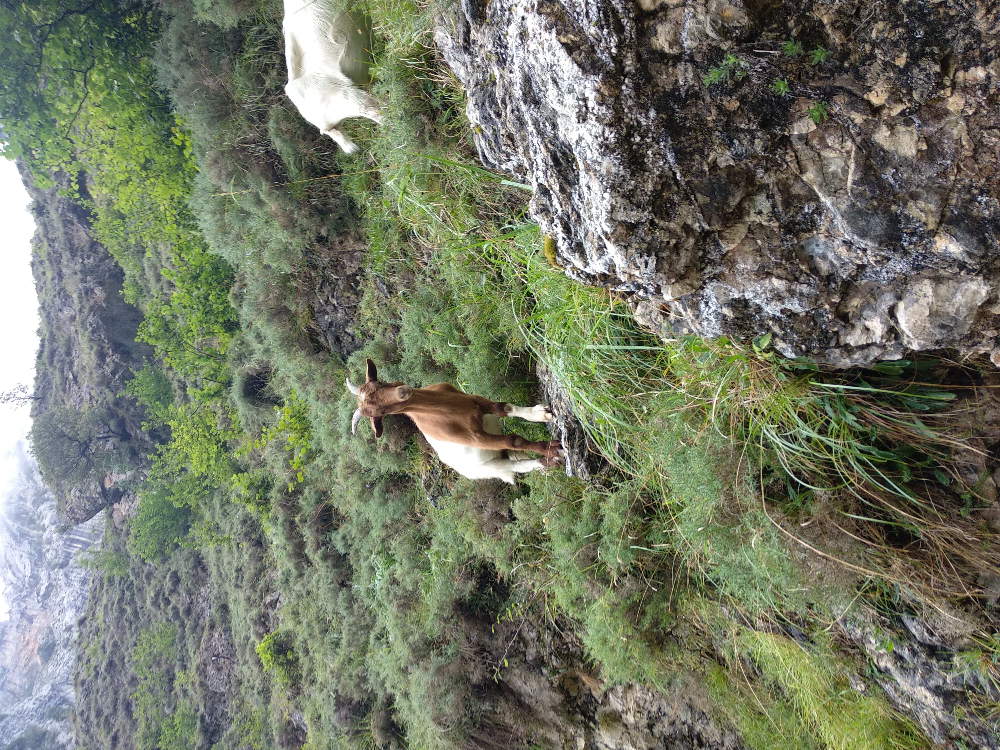

In [8]:
target_image

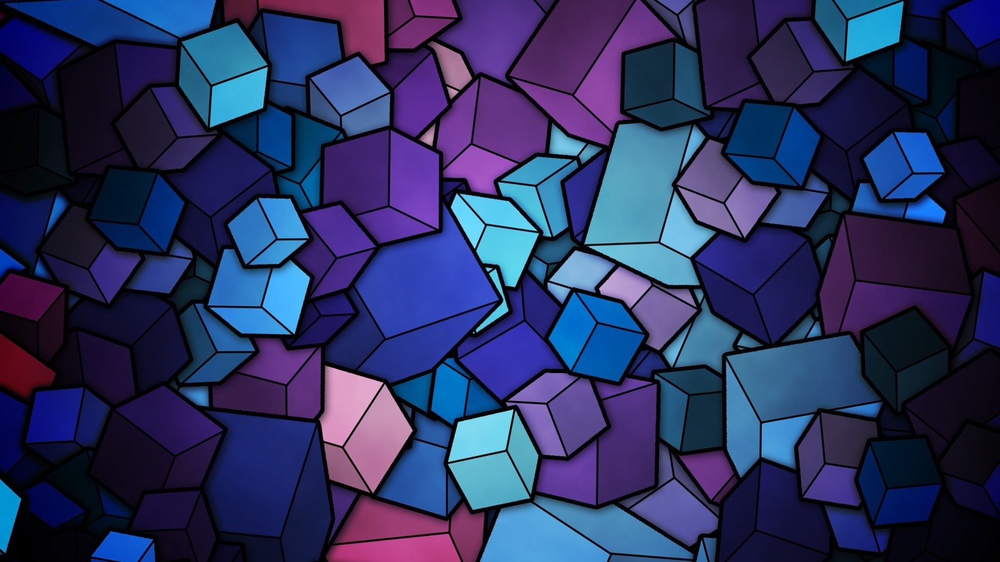

In [9]:
style_image

## <font color="#9E1B32">Funciones auxiliares

In [10]:
#Función que carga una imagen con las dimensiones de la iamgen generada. La pasamos a array y realizamos el preprocess de VGG19
#para que entre bien al modelo
import numpy as np
from keras.applications import vgg19
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_height, img_width))
    img = img_to_array(img) 
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

In [11]:
def deprocess_image(x):
#Estos valores son la media de cada canal en el modelo VGG19. Los sumamos para hacer el desproceso:    
    x[:, :, 0] += 103.939  
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    x = x[:, :, ::-1]   #El modelo VGG19 nos da 'BGR', lo pasamos a 'RGB'
    x = np.clip(x, 0, 255).astype('uint8')
    return x

## <font color="#9E1B32">Cargamos el modelo preentrenado y le aplicamos las tres imagenes

El target y el estilo las ponemos como constantes y la generada como placeholder, ya que va a ir variando.

In [15]:
from keras import backend as K
#Cargamos las imágenes contenido y estilo con el tamaño de la generada:
target_image = K.constant(preprocess_image(target_image_path))
style_reference_image = K.constant(preprocess_image(style_reference_image_path))
#Placeholder de la imagen generada
combination_image = K.placeholder((1, img_height, img_width, 3))
#Input del modelo, combinación de las tres imagenes
input_tensor = K.concatenate([target_image, style_reference_image, combination_image], axis=0)
#Cargamos el modelo vgg19 con el input deseado de las tres imagenes y los pesos entrenados
model = vgg19.VGG19(input_tensor=input_tensor, weights='imagenet', include_top=False)
print('Model loaded.')

Model loaded.


## <font color="#9E1B32">Funciones de pérdida

La función de contenido viene dada por una norma L2 entre la activación de una de las capas superiores de nuestra imagen de contenido y la generada.

La función de estilo está determinada por la diferencia de correlación entre la imagen estilo y la generada en distintas capas. Para calcularla necesitamos una función auxiliar (gram matrix).

Por último, tenemos la función de perdida variación total. Esta nos ayuda a que la imagen sea continua y evitar que este pixelada. Es un regularizador.

In [16]:
def content_loss(base, combination):
    return K.sum(K.square(combination - base))

In [17]:
def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    #gram matrix es el cuadrado de una matriz a través de las features de cada capa
    gram = K.dot(features, K.transpose(features))
    return gram

In [18]:
def style_loss(style, combination):
    #Calculamos el valor de grama para cada foto
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_height * img_width
    return K.sum(K.square(S - C)) / (4. * (channels ** 2) * (size ** 2))

In [19]:
#Opera en los pixeles de la imagen generada. Da continuidad a la imagen
def total_variation_loss(x):
    a = K.square(x[:, :img_height - 1, :img_width - 1, :] - x[:, 1:, :img_width - 1, :])
    b = K.square(x[:, :img_height - 1, :img_width - 1, :] - x[:, :img_height - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

La loss que vamos a minimizar es una ponderación de las tres anteriores.

Vamos ahora a ver que layers usaremos para calcularlas.

In [20]:
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])
content_layer = 'block5_conv2'
style_layers = ['block1_conv1','block2_conv1','block3_conv1','block4_conv1','block5_conv1']

#Parámetros del peso de la función de perdida. Cuanto más alto sea el estilo y el contenido más se pareceran a sus respectivas
#imagenes
total_variation_weight = 1e-4
style_weight = 1.
content_weight = 0.025

In [21]:
loss = K.variable(0.) #Inicializamos
#Añadimos la pérdida de la función de contenido:
layer_features = outputs_dict[content_layer] 
target_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :] 
loss += content_weight * content_loss(target_image_features, combination_features)
#Añadimos la pérdida de la función de estilo:
for layer_name in style_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :]
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss += (style_weight / len(style_layers)) * sl
#Suavizamos/Regulamos:
loss += total_variation_weight * total_variation_loss(combination_image)

W1021 12:51:39.173086 29560 variables.py:2429] Variable += will be deprecated. Use variable.assign_add if you want assignment to the variable value or 'x = x + y' if you want a new python Tensor object.


## <font color="#9E1B32">Gradient descent

Usaremos el  L-BFGS algoritmo. Es un método quasi-Newton para encontrar mínimos de funciones. Este método está implementado en Scipy, pero es ineficiente ya que hay que calcular gradientes y loss por separado. Vamos a solventarlo creando una clase que los calcule a la vez, devuelve el valor de loss la primera vez que se le llame y almacene en cache los gradientes para la siguiente llamada.

In [22]:
grads = K.gradients(loss, combination_image)[0] #cogemos los gradientes de la imagen generada respecto a la función loss
fetch_loss_and_grads = K.function([combination_image], [loss, grads]) #funcion que extrae los gradientes y loss
class Evaluator(object):
    def __init__(self):
        self.loss_value = None
        self.grads_values = None
    def loss(self, x):  #obtenemos la loss y guardamos los grads 
        assert self.loss_value is None
        x = x.reshape((1, img_height, img_width, 3))
        outs = fetch_loss_and_grads([x])
        loss_value = outs[0]
        grad_values = outs[1].flatten().astype('float64')
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value
    def grads(self, x): #una vez que ya tenemos la loss nos guardamos los gradientes de la anteriro función 
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values
evaluator = Evaluator()

W1021 12:52:39.775098 29560 deprecation.py:323] From C:\Users\ian.delaoliva\AppData\Local\Continuum\anaconda3\envs\CV\lib\site-packages\tensorflow\python\ops\math_grad.py:1205: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## <font color="#9E1B32">Entrenamiento Style-transfer

Ya solo nos queda entrenar. Se nos guarda para cada iteración la imagen generada (por si queremos parar antes o el resultado no nos convence). El entrenamiento puede tardar bastante depende mucho del tamaño de la imagen generada. Puedes ir viendo las fotos según acaba cada iteración. 

__Recuerda introducir las fotos en una carpeta o borrarlas si ya has entrenado una vez, si no dará error porque la foto ya existe__.

In [23]:
from scipy.optimize import fmin_l_bfgs_b
from scipy.misc import imsave
import time
result_prefix = 'my_result'
iterations = 20  #número de epochs
x = preprocess_image(target_image_path) #preparamos la imagen de contenido
x = x.flatten()  #LFBGs necesita que los vectores estén flatten
for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    #Realizamos la optimización L-BFGS sobre los píxeles de la imagen generada para minimizar nuestra función de pérdida.
    #Notar que hemos pasado la loss y los gradientes en dos parámetros separados.
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x, fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    img = x.copy().reshape((img_height, img_width, 3))
    img = deprocess_image(img)
    fname = result_prefix + '_at_iteration_%d.png' % (i+1)
    imsave(fname, img)
    print('Image saved as', fname)
    end_time = time.time()
    print('Iteration %d completed in %ds' % ((i+1), end_time - start_time))

Start of iteration 0
Current loss value: 19127777000.0
Image saved as my_result_at_iteration_1.png
Iteration 1 completed in 146s
Start of iteration 1


C:\Users\ian.delaoliva\AppData\Local\Continuum\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:18: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


Current loss value: 7553954300.0
Image saved as my_result_at_iteration_2.png
Iteration 2 completed in 154s
Start of iteration 2
Current loss value: 4689510000.0
Image saved as my_result_at_iteration_3.png
Iteration 3 completed in 155s
Start of iteration 3
Current loss value: 3334269700.0
Image saved as my_result_at_iteration_4.png
Iteration 4 completed in 159s
Start of iteration 4
Current loss value: 2618117400.0
Image saved as my_result_at_iteration_5.png
Iteration 5 completed in 144s
Start of iteration 5
Current loss value: 2085424400.0
Image saved as my_result_at_iteration_6.png
Iteration 6 completed in 151s
Start of iteration 6
Current loss value: 1771440300.0
Image saved as my_result_at_iteration_7.png
Iteration 7 completed in 163s
Start of iteration 7
Current loss value: 1517549200.0
Image saved as my_result_at_iteration_8.png
Iteration 8 completed in 152s
Start of iteration 8
Current loss value: 1347801600.0
Image saved as my_result_at_iteration_9.png
Iteration 9 completed in 15

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec
def mostrar_images(paths):
    fig=plt.figure(figsize=(16,16))
    for j in paths:
        img = load_img(j)
        plt.imshow(img)
        path_txt=j.split('/')[-1].split('.')[0]
        plt.title(path_txt)
        plt.show()

In [27]:
a= "./cabra.jpg"
b= "./estilo2.jpg"
c= "./my_result_at_iteration_1.png"
d= "./my_result_at_iteration_10.png"
e= "./my_result_at_iteration_20.png"
paths=[a,b,c,d,e]

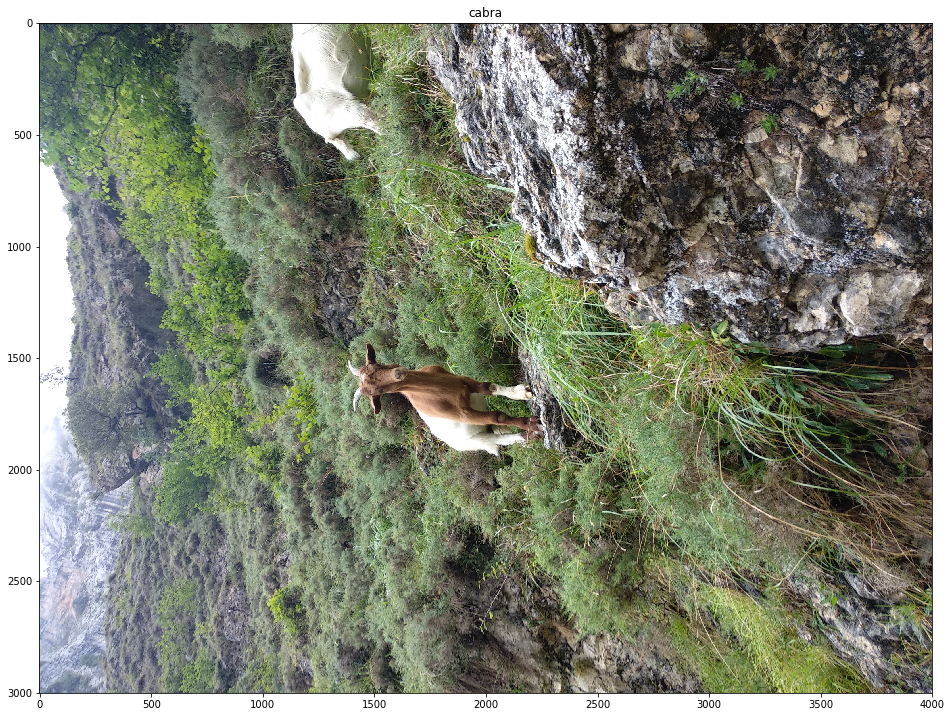

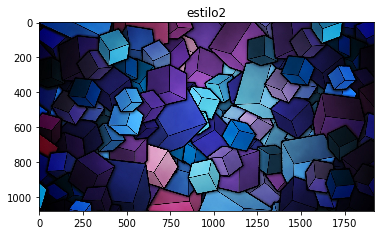

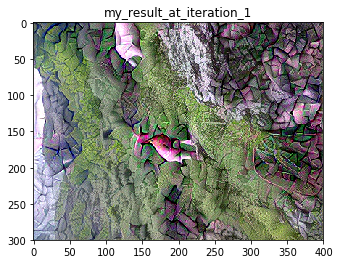

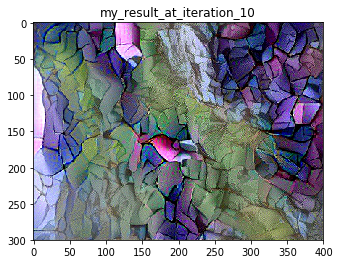

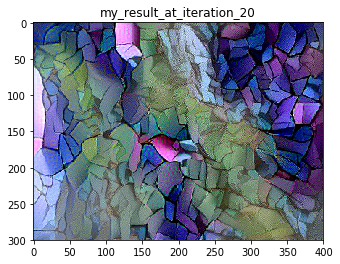

In [28]:
mostrar_images(paths)

### Ejemplo

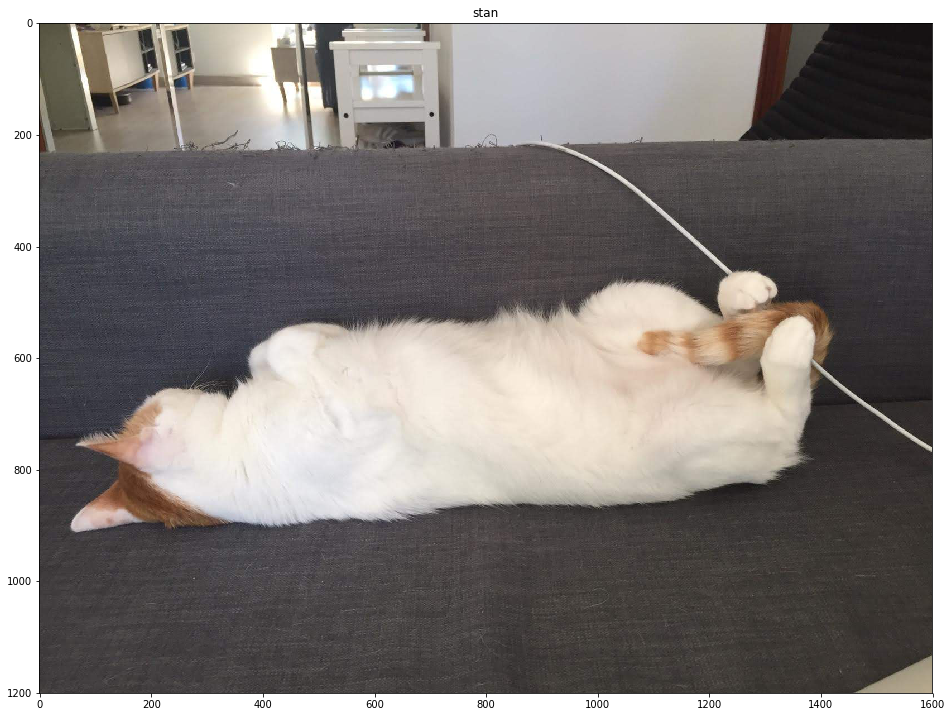

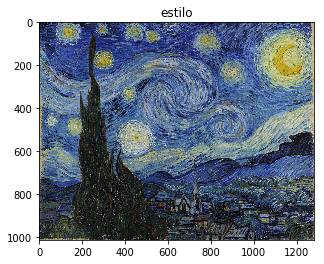

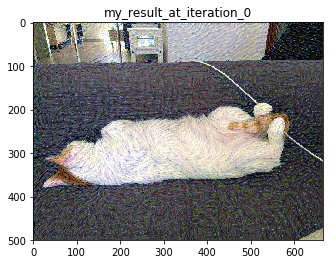

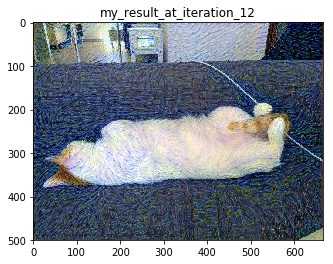

In [31]:
fig=plt.figure(figsize=(16,16))

for j in paths:
    img = load_img(j)
    plt.imshow(img)
    path_txt=j.split('/')[-1].split('.')[0]
    plt.title(path_txt)
    plt.show()

# Cosas de GPU (IGNORAR) 

In [1]:
import tensorflow as tf
print('Tensorflow: ', tf.__version__)

Tensorflow:  1.14.0


In [1]:
from numba import cuda
def reset_keras():
    cuda.select_device(0)
    cuda.close()

In [21]:
!nvcc -V

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Wed_Apr_24_19:11:20_Pacific_Daylight_Time_2019
Cuda compilation tools, release 10.1, V10.1.168


In [19]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 1663636957796036485
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 1462163865
locality {
  bus_id: 1
  links {
  }
}
incarnation: 13243176162845854832
physical_device_desc: "device: 0, name: GeForce 930M, pci bus id: 0000:03:00.0, compute capability: 5.0"
]


In [1]:
from keras import backend as K
K.tensorflow_backend._get_available_gpus()

Using TensorFlow backend.


['/job:localhost/replica:0/task:0/device:GPU:0']

In [1]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID";
 
# The GPU id to use, usually either "0" or "1";
os.environ["CUDA_VISIBLE_DEVICES"]="0";  
 
# Do other imports now...
import keras
import tensorflow as tf

config = tf.ConfigProto()
config.gpu_options.allow_growth=True
config.gpu_options.per_process_gpu_memory_fraction = 0.9
keras.backend.tensorflow_backend.set_session(tf.Session(config=config)) 

Using TensorFlow backend.
